Author: Max Matthews and Frinze Erin Lapuz (22711649)

This is the IPython Jupyter Notebook for generating the PDF report, documentation, and generating the staging_data.

To generate html, pdf and tex file, run the following command `generate_report.bat` in the command line. You may need to have Anaconda activated, Jupyter NBconvert, and LaTex renderer (eg. MikTex) in your environment to do this.

# Data Cleaning and Profiling
There are many ways to perform data cleaning and profiling, but in this process, IPython Notebook will be used for the following reasons:

- The anaylsts are proficient in Python
- The report can be integrated with code for specific sections of the analysis
- highly repeatable and automated procedures using scripts
- data exploratory and anomaly detection can easily be performed and presented through charts

## Packages



## Data Cleaning and Profiling

The cleaning process will be done in Python - Jupyter Notebook. The packages that will be used are built-in the Anaconda package, except for `pandas_profiling` from https://github.com/pandas-profiling/pandas-profiling which is used for doing detailed exploratory analysis of data.

Data profiling is important to measure the quality of data. Measurement of data quality is important to determine the data anomalies and inconsistencies which decides the transformations that will need to be done.

The data profiling reports will be generated with Pandas Profiling and SSIS. Certain portions of these data profiling reports will be explained, and these reports will be attached as an Appendix.

Note: This is the install script for the packages
`pip install mlxtend pandas-profiling[notebook]`

In [1]:
# Packages

# Data analytics and Plotting
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# Data Profiling
from pandas_profiling import ProfileReport

# Association Rule Mining
from mlxtend.frequent_patterns import apriori, association_rules

In [2]:
raw_data = pd.read_csv("./data/raw/mobile_price.csv")
raw_metadata = pd.read_excel("./data/raw/ColumnDescription.xlsx",index_col="Column")

In [3]:
staging_data = raw_data.copy()

In [4]:
raw_data

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_category
0,0,842,no,2.2,no,1,0,7,0.6,188,...,20,756,2549,9,7,19,no,0,yes,0
1,1,1021,yes,0.5,YES,0,1,53,0.7,136,...,905,1988,2631,17,3,7,yes,1,no,0
2,2,563,yes,0.5,Yes,2,1,41,0.9,145,...,1263,1716,2603,11,2,9,yes,1,no,0
3,3,615,has,2.5,no,0,0,10,0.8,131,...,1216,1786,2769,16,8,11,Yes,0,no,0
4,4,1821,yes,1.2,NO,13,1,44,0.6,141,...,1208,1212,1411,8,2,15,Yes,1,no,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,1995,794,yes,0.5,yes,0,1,2,0.8,106,...,1222,1890,668,13,4,19,yes,1,No,0
1996,1996,1965,yes,2.6,yes,0,0,39,0.2,187,...,915,1965,2032,11,10,16,has,1,yes,0
1997,1997,1911,no,0.9,yes,1,1,36,0.7,108,...,868,1632,3057,9,1,5,yes,1,no,1
1998,1998,1512,no,0.9,not,4,1,46,0.1,145,...,336,670,869,18,10,19,Yes,1,yes,0


In [5]:
raw_metadata.to_dict()["Explaination"]

{'id': 'ID',
 'battery_power': 'Total energy a battery can store in one time measured in mAh',
 'blue': 'Has bluetooth or not',
 'clock_speed': 'speed at which microprocessor executes instructions',
 'dual_sim': 'Has dual sim support or not',
 'fc': 'Front Camera mega pixels ',
 'four_g': 'Has 4G or not. 1 = yes , 0 = no',
 'int_memory': 'internal Memory in Gigabytes',
 'm_dep': 'Mobile Depth in cm',
 'mobile_wt': 'Weight of mobile phone',
 'n_cores': 'Number of cores of processor',
 'pc': 'Primary Camera mega pixels',
 'px_height': 'Pixel Resolution Height',
 'px_width': 'Pixel Resolution Width',
 'ram': 'Random Access Memory in Mega Bytes',
 'sc_h': 'Screen Height of mobile in cm',
 'sc_w': 'Screen Width of mobile in cm',
 'talk_time': 'longest time that a single battery charge will last when you are',
 'three_g': 'Has 3G or not',
 'touch_screen': 'Has touch screen or not, 1 = yes, 0 = no',
 'wifi': 'Has wifi or not',
 'price_category': 'This is the target variable with indicating if

In [6]:
metadata_dict = raw_metadata.to_dict()["Explaination"]
raw_profile = ProfileReport(raw_data, explorative=True, orange_mode=True)

# Set Metadata
raw_profile.set_variable("variables.descriptions",metadata_dict)
                               
raw_profile.to_file("./profile_reports/raw_data_profile.html")
raw_profile

## Raw Field Interpretation and Cleaning Strategy

### id
The `id` field is unique, and it seems to be a good candidate for primary key

### `battery_power`
The `battery_power` has 1094 distinct counts, approximately half the distinct counts of `id`. Yada yada yada about the battery histogram

In [7]:
def create_discretized_col(df, target_col, new_col_name=None, is_zero_its_own_category=True):
    """
    This function discretises the column
    """
    # Default value of new col
    if new_col_name is None:
        new_col_name = f"{target_col}_category"
        
    col_holder = df[target_col]
    df[new_col_name] = "0" # Initialise
    
    if is_zero_its_own_category:
        df.loc[col_holder>0, new_col_name] = pd.cut(col_holder[col_holder>0],bins=4,include_lowest=True).astype(str)
    else:
        df.loc[:, new_col_name] = pd.cut(col_holder,bins=4,include_lowest=True).astype(str)
    
    return df

In [8]:
staging_data = create_discretized_col(staging_data, "battery_power", is_zero_its_own_category = False)

### `blue`
The `blue` ("has bluetooth" field) is a boolean data type expressed in string with inconsistencies of 10 distinct values that all refers to either the phone has bluetooth or not. Hence this attribute needs to be cleaned.

In [9]:
def clean_blue(value):
    """
    Converts String representation of Boolean ("yes", "has")/("no","not") to True/False
    """
    if value.lower() in ["yes","has"]:
        return True
    elif value.lower() in ["no","not"]:
        return False
    return None

staging_data["has_bluetooth"] = staging_data["blue"].apply(clean_blue)
staging_data["has_bluetooth"]

0       False
1        True
2        True
3        True
4        True
        ...  
1995     True
1996     True
1997    False
1998    False
1999     True
Name: has_bluetooth, Length: 2000, dtype: bool

In [10]:
# Clone the staging metadata
staging_metadata = raw_metadata.copy()

# By default the new_name is the old_name
staging_metadata["new_name"] = staging_metadata.index

In [11]:
# Rename metadata
staging_metadata.loc["blue","new_name"] = "has_bluetooth"

### `clock_speed`
The `clock_speed` attribute has 26 distinct values for which 413 of the records have value `0.5`. Hence the distribution of values in the histogram is right skewed. These values will be discretised in 4 Bins (a decision that was made) that allows association rule mining.

In [12]:
staging_data = create_discretized_col(staging_data, "clock_speed", is_zero_its_own_category = False)

### `dual_sim`
The `dual_sim` attirbute is similar to `blue` attribute wherein it is a boolean datatype with inconsistencies sppread to 10 string distinct values. Hence, the procedure of cleaning will be similar.

In [13]:
clean_dual_sim = clean_blue

staging_data["has_dual_sim"] = staging_data["dual_sim"].apply(clean_dual_sim)
staging_data["has_dual_sim"]

0       False
1        True
2        True
3       False
4       False
        ...  
1995     True
1996     True
1997     True
1998    False
1999     True
Name: has_dual_sim, Length: 2000, dtype: bool

In [14]:
# Rename metadata
staging_metadata.loc["dual_sim","new_name"] = "has_dual_sim"

### `fc`
The `fc` attribute has 474 (23.7% of the dataset) zero values in the dataset which indicate that majority of phones in the dataset do not have front cameras. Hence when the values gets evenly discretized, 0 has its own category. Furthermore, there are 20 distinct `fc` attributes.

In [15]:
staging_data["front_cam_resolution"] = staging_data["fc"]
staging_data = create_discretized_col(staging_data, "front_cam_resolution", is_zero_its_own_category = True)
# Zero values to nan
# staging_data.loc[staging_data["front_cam_resolution"]==0,"front_cam_resolution"] = np.nan

In [16]:
# Rename metadata
staging_metadata.loc["fc","new_name"] = "front_cam_resolution"

### `four_g`
The `four_g` attribute is a boolean attribute indicated by "yes=1" and "no=1" to having 4G capability. To make this data uniform to the other boolean datatypes in the dataset, this will be converted from numeric (0 or 1) to boolean.

In [17]:
def clean_four_g(value):
    if value == 1:
        return True
    elif value == 0:
        return False
    return None

staging_data["has_four_g"] = staging_data["four_g"].apply(clean_four_g)
staging_data["has_four_g"] 

0       False
1        True
2        True
3       False
4        True
        ...  
1995     True
1996    False
1997     True
1998     True
1999     True
Name: has_four_g, Length: 2000, dtype: bool

In [18]:
# Rename metadata
staging_metadata.loc["four_g","new_name"] = "has_four_g"

### `int_memory`
The `int_memory` attribute has 63 distinct values that varies as shown in the histogram. There are no records of phones having `0 GB` as the storage which indicates....

In [19]:
staging_data = create_discretized_col(staging_data, "int_memory", is_zero_its_own_category = False)

### `m_dep`
The `m_dep` attribute has 10 distinct values that varies as shown in the histogram. The minimum `m_dep` is `0.1 cm ~ 1 mm` . 

In [20]:
staging_data["mobile_depth"] = staging_data["m_dep"] 
staging_data = create_discretized_col(staging_data, "mobile_depth", is_zero_its_own_category = False)

In [21]:
# Rename metadata
staging_metadata.loc["m_dep","new_name"] = "mobile_depth"

### `mobile_wt`
The `mobile_wt` attribute has 121 distinct values that varies as shown in the histogram. The minimum is `80` and the maximum is `200`.

NOTE: WHAT IS THE UNIT FOR THIS?

In [22]:
staging_data["mobile_weight"] = staging_data["mobile_wt"] 
staging_data = create_discretized_col(staging_data, "mobile_weight", is_zero_its_own_category = False)

In [23]:
# Rename metadata
staging_metadata.loc["mobile_wt","new_name"] = "mobile_weight"

### `n_cores`
The `n_cores` attribute looks almost uniform in the range `1-8`.

In [24]:
staging_data["number_of_cores"] = staging_data["n_cores"]

In [25]:
# Rename metadata
staging_metadata.loc["n_cores","new_name"] = "number_of_cores"

### `pc`
The `pc` attribute has 21 distinct values with 101 (5.1% of the dataset) with zero values. Similar to `fc`, these zero values has been converted to `nan`. 

In [26]:
staging_data["primary_cam_resolution"] = staging_data["pc"]
staging_data = create_discretized_col(staging_data, "primary_cam_resolution", is_zero_its_own_category = True)

# Zero values to nan
# staging_data.loc[staging_data["primary_cam_resolution"]==0,"primary_cam_resolution"] = np.nan

In [27]:
# Rename metadata
staging_metadata.loc["pc","new_name"] = "primary_cam_resolution"

### `px_height`
The `px_height` attribute has a right skewed normal distribution with a mean value of `645` pixels and `443.79` standard deviation in the range `0-1960`. ???? Why small heights

In [28]:
staging_data = create_discretized_col(staging_data, "px_height", is_zero_its_own_category = False)

### `px_width`
The `px_width` attribute has a varying distribution of values in the range 500 to 1998.

In [29]:
staging_data = create_discretized_col(staging_data, "px_width", is_zero_its_own_category = False)

### `ram`
The `ram` attribute has a varying distribution of values in the range `256-3998`. Why does it vary??? shouldn't it be base 2?

In [30]:
staging_data = create_discretized_col(staging_data, "ram", is_zero_its_own_category = False)

### `sc_h`
The `sc_h` attributes has 15 distinct values with a range of `5-19`.

In [31]:
staging_data["screen_height"] = staging_data["sc_h"]
staging_data = create_discretized_col(staging_data, "screen_height", is_zero_its_own_category = False)

In [32]:
# Rename metadata
staging_metadata.loc["sc_h","new_name"] = "screen_height"

### `sc_w`
The `sc_w` attribute has 19 distinct values with a range of `0-18` with 180 zero values.

In [33]:
staging_data["screen_width"] = staging_data["sc_w"]
staging_data = create_discretized_col(staging_data, "screen_width", is_zero_its_own_category = False)

In [34]:
# Rename metadata
staging_metadata.loc["sc_w","new_name"] = "screen_width"

### `talk_time`
The `talk_time` attribute has 19 distinct values with a range `2-20`.

In [35]:
staging_data = create_discretized_col(staging_data, "talk_time", is_zero_its_own_category = False)

### `three_g`
The `three_g` attirbute is similar to `blue` and `dual_sim` attribute wherein it is a boolean datatype with inconsistencies sppread to 10 string distinct values. Hence, the procedure of cleaning will be similar.

In [36]:
clean_three_g = clean_blue

staging_data["has_three_g"] = staging_data["three_g"].apply(clean_three_g)
staging_data["has_three_g"]

0       False
1        True
2        True
3        True
4        True
        ...  
1995     True
1996     True
1997     True
1998     True
1999     True
Name: has_three_g, Length: 2000, dtype: bool

In [37]:
# Rename metadata
staging_metadata.loc["three_g","new_name"] = "has_three_g"

### `touch_screen`
The `touch_screen` attribute is a boolean attribute similar to the representation of `four_g`. Hence, the cleaning procedure is similar 

In [38]:
clean_touch_screen = clean_four_g

staging_data["has_touch_screen"] = staging_data["touch_screen"].apply(clean_touch_screen)
staging_data["has_touch_screen"] 

0       False
1        True
2        True
3       False
4        True
        ...  
1995     True
1996     True
1997     True
1998     True
1999     True
Name: has_touch_screen, Length: 2000, dtype: bool

In [39]:
# Rename metadata
staging_metadata.loc["touch_screen","new_name"] = "has_touch_screen"

### `wifi`
The `wifi` attirbute is similar to `blue`,`dual_sim` and `three_g` attribute wherein it is a boolean datatype with inconsistencies spread to 10 string distinct values. Hence, the procedure of cleaning will be similar.

In [40]:
clean_wifi = clean_blue

staging_data["has_wifi"] = staging_data["wifi"].apply(clean_wifi)
staging_data["has_wifi"]

0        True
1       False
2       False
3       False
4       False
        ...  
1995    False
1996     True
1997    False
1998     True
1999     True
Name: has_wifi, Length: 2000, dtype: bool

In [41]:
# Rename metadata
staging_metadata.loc["wifi","new_name"] = "has_wifi"

### `price_category`
The `price_category` attribute is a boolean attribute similar to the representation of `four_g` and `touch_screen`. Hence, the cleaning procedure is similar 

In [42]:
clean_price_category = clean_four_g

staging_data["is_expensive"] = staging_data["price_category"].apply(clean_price_category)
staging_data["is_expensive"] 

0       False
1       False
2       False
3       False
4       False
        ...  
1995    False
1996    False
1997     True
1998    False
1999     True
Name: is_expensive, Length: 2000, dtype: bool

In [43]:
# Rename metadata
staging_metadata.loc["price_category","new_name"] = "is_expensive"

In [44]:
staging_data.columns

Index(['id', 'battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc',
       'four_g', 'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc',
       'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi', 'price_category', 'battery_power_category',
       'has_bluetooth', 'clock_speed_category', 'has_dual_sim',
       'front_cam_resolution', 'front_cam_resolution_category', 'has_four_g',
       'int_memory_category', 'mobile_depth', 'mobile_depth_category',
       'mobile_weight', 'mobile_weight_category', 'number_of_cores',
       'primary_cam_resolution', 'primary_cam_resolution_category',
       'px_height_category', 'px_width_category', 'ram_category',
       'screen_height', 'screen_height_category', 'screen_width',
       'screen_width_category', 'talk_time_category', 'has_three_g',
       'has_touch_screen', 'has_wifi', 'is_expensive'],
      dtype='object')

In [45]:
cleaned_data = staging_data[["id","battery_power","has_bluetooth",
                             "clock_speed","has_dual_sim","front_cam_resolution",
                             "has_four_g",
                            "int_memory","mobile_depth","mobile_weight",
                             "number_of_cores", "primary_cam_resolution", "px_height",
                             "px_width", "ram", "screen_height",
                             "screen_width", "talk_time", "has_three_g",
                             "has_touch_screen", "has_wifi", "is_expensive"
                            ]]
discretised_data = staging_data[["battery_power_category","has_bluetooth",
                             "clock_speed_category","has_dual_sim","front_cam_resolution_category", "has_four_g",
                            "int_memory_category","mobile_depth_category","mobile_weight_category",
                             "number_of_cores", "primary_cam_resolution_category", "px_height_category",
                             "px_width_category", "ram_category", "screen_height_category",
                             "screen_width_category", "talk_time_category", "has_three_g",
                             "has_touch_screen", "has_wifi", "is_expensive"
                            ]]

In [46]:
# Cleaned metadata
cleaned_metadata = staging_metadata.set_index("new_name")
cleaned_metadata_dict = cleaned_metadata.to_dict()["Explaination"]
cleaned_metadata

,Explaination
new_name,
id,ID
battery_power,Total energy a battery can store in one time m...
has_bluetooth,Has bluetooth or not
clock_speed,speed at which microprocessor executes instruc...
has_dual_sim,Has dual sim support or not
front_cam_resolution,Front Camera mega pixels
has_four_g,"Has 4G or not. 1 = yes , 0 = no"
int_memory,internal Memory in Gigabytes
mobile_depth,Mobile Depth in cm


In [47]:
cleaned_data_profile = ProfileReport(cleaned_data, explorative=True, orange_mode=True)

# Set Metadata
cleaned_data_profile.set_variable("variables.descriptions",cleaned_metadata_dict)
                               
cleaned_data_profile.to_file("./profile_reports/cleaned_data_profile.html")
cleaned_data_profile

C:\Users\frinz\anaconda3\lib\site-packages\pandas\core\frame.py:4296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [48]:
# Export the cleaned_data
cleaned_data.to_csv("./data/cleaned/mobile_price.csv",index=False)

In [49]:
# Exploring the data
# sns.pairplot(vars=,data=cleaned_data, hue="is_expensive")

In [50]:
#for column in cleaned_data.drop(["is_expensive","id"],axis="columns").columns:
    #sns.histplot(data=cleaned_data, x=column, hue="is_expensive")
    

In [51]:
np.sort(np.unique(discretised_data["battery_power_category"].astype(str)))

array(['(1249.5, 1623.75]', '(1623.75, 1998.0]', '(499.502, 875.25]',
       '(875.25, 1249.5]'], dtype=object)

In [52]:
# Sort all the columns based on value (this will determine the Ordinal Encoder)
discretised_ordered_data = discretised_data.copy()
for column in discretised_data.columns:
    unique_sorted_values =np.sort(np.unique(discretised_data[column].astype(str)))
    dictionary = {}
    for numeric_value in range(len(unique_sorted_values)):
        dictionary[unique_sorted_values[numeric_value]] = numeric_value
    discretised_ordered_data[column] = discretised_data[column].apply(lambda value: dictionary[str(value)])

discretised_ordered_data

,battery_power_category,has_bluetooth,clock_speed_category,has_dual_sim,front_cam_resolution_category,has_four_g,int_memory_category,mobile_depth_category,mobile_weight_category,number_of_cores,...,px_height_category,px_width_category,ram_category,screen_height_category,screen_width_category,talk_time_category,has_three_g,has_touch_screen,has_wifi,is_expensive
0,2,0,2,0,0,0,0,2,2,1,...,0,2,1,3,2,2,0,0,1,0
1,3,1,0,1,4,1,3,2,0,2,...,2,1,1,1,0,3,1,1,0,0
2,2,1,0,1,0,1,2,3,1,4,...,3,1,1,3,0,3,1,1,0,0
3,2,1,3,0,4,0,0,3,0,5,...,3,1,1,1,2,3,1,0,0,0
4,1,1,1,0,1,1,2,2,1,1,...,3,3,0,2,0,1,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,2,1,0,1,4,1,0,3,3,5,...,3,1,2,0,0,2,1,1,0,0
1996,1,1,3,1,4,0,2,0,2,3,...,2,1,0,3,3,2,1,1,1,0
1997,1,0,0,1,0,1,2,2,3,7,...,2,1,1,3,0,0,1,1,0,1
1998,0,0,0,0,0,1,2,0,1,4,...,0,2,2,1,3,2,1,1,1,0


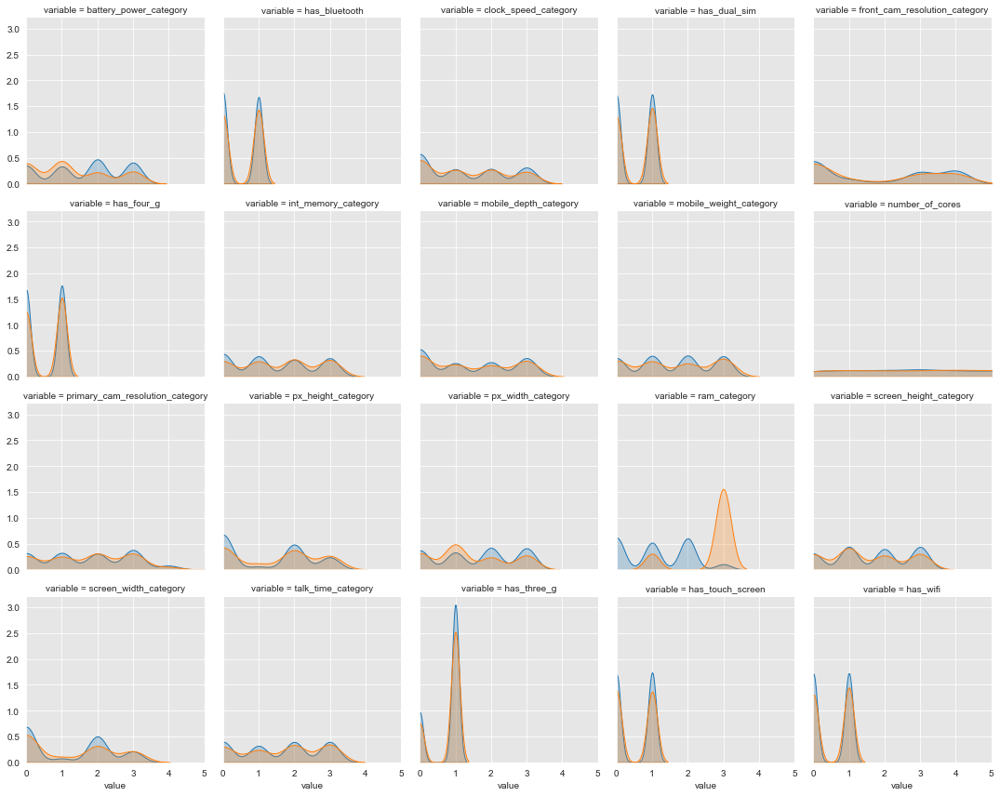

In [53]:
melted_data = pd.melt(discretised_ordered_data, "is_expensive", discretised_ordered_data.drop(["is_expensive"],axis="columns"))
g = sns.FacetGrid(melted_data, col="variable", hue="is_expensive", col_wrap=5)
g.map(sns.kdeplot, "value", shade=True)
plt.xlim(0,5)
plt.show()


In [54]:
melted_data

,is_expensive,variable,value
0,0,battery_power_category,2
1,0,battery_power_category,3
2,0,battery_power_category,2
3,0,battery_power_category,2
4,0,battery_power_category,1
...,...,...,...
39995,0,has_wifi,0
39996,0,has_wifi,1
39997,1,has_wifi,0
39998,0,has_wifi,1


# Association rule mining

The idea of association rule mining (ARM) is to gather the characteristics that occurs frequently. The approach taken is to take the characteristics of each of the phone in the record with the following strategy:

- keep the current cleaned data especially the boolean values
- discretise the numeric values

Before the "apriori" runs, the data should be in the form similar to

|has_bluetooth|has_dual_sim|battery_power_0-100|...|
|---	|---	|---	|---	|
|True|False|True|True|
|True|True|False|True|
|False|True|True|False|


In [57]:
# restructuring cleaned_data for association rule mining
ARM_data = discretised_data # .drop("id",axis="columns")

# Boolean Tables
ARM_structured_data = ARM_data.copy()[[item[0] for item in zip(ARM_data.columns,ARM_data.dtypes) if item[1] == np.bool]]

# Discretise data
non_boolean_values = ARM_data[[item[0] for item in zip(ARM_data.columns,ARM_data.dtypes) if item[1] != np.bool]]

# Adding extra columns from discretise data into columns
for non_boolean_column in non_boolean_values.columns:
    unique_values_in_column = ARM_data[non_boolean_column].unique()
    for category_name in unique_values_in_column:
        # Assign true if the current category name matches the data
        ARM_structured_data[f"{non_boolean_column}_{category_name}"] = ARM_data[non_boolean_column]==category_name


In [58]:
ARM_structured_data.to_csv("./data/cleaned/ARM_item_characteristics.csv",index=False)

In [59]:
ARM_structured_data.columns

Index(['has_bluetooth', 'has_dual_sim', 'has_four_g', 'has_three_g',
       'has_touch_screen', 'has_wifi', 'is_expensive',
       'battery_power_category_(499.502, 875.25]',
       'battery_power_category_(875.25, 1249.5]',
       'battery_power_category_(1623.75, 1998.0]',
       'battery_power_category_(1249.5, 1623.75]',
       'clock_speed_category_(1.75, 2.375]',
       'clock_speed_category_(0.497, 1.125]',
       'clock_speed_category_(2.375, 3.0]',
       'clock_speed_category_(1.125, 1.75]',
       'front_cam_resolution_category_(0.981, 5.5]',
       'front_cam_resolution_category_0',
       'front_cam_resolution_category_(10.0, 14.5]',
       'front_cam_resolution_category_(5.5, 10.0]',
       'front_cam_resolution_category_(14.5, 19.0]',
       'int_memory_category_(1.937, 17.5]', 'int_memory_category_(48.5, 64.0]',
       'int_memory_category_(33.0, 48.5]', 'int_memory_category_(17.5, 33.0]',
       'mobile_depth_category_(0.55, 0.775]',
       'mobile_depth_category_(0.77

In [60]:
# This defines what is considered as a minimum item
MINIMUM_SUPPORT = 0.1

frequent_items = apriori(ARM_structured_data,min_support=MINIMUM_SUPPORT,use_colnames=True, verbose=True)
frequent_items

Processing 570 combinations | Sampling itemset size 5 4


,support,itemsets
0,0.4950,(has_bluetooth)
1,0.5095,(has_dual_sim)
2,0.5215,(has_four_g)
3,0.7615,(has_three_g)
4,0.5030,(has_touch_screen)
...,...,...
712,0.1165,"(screen_width_category_(-0.019, 4.5], has_wifi..."
713,0.1165,"(ram_category_(3062.5, 3998.0], is_expensive, ..."
714,0.1000,"(clock_speed_category_(0.497, 1.125], screen_w..."
715,0.1100,"(front_cam_resolution_category_(0.981, 5.5], p..."


In [61]:
# 
MINIMUM_CONFIDENCE_THRESHOLD = 0

rules_by_confidence = association_rules(frequent_items, metric="confidence", min_threshold=MINIMUM_CONFIDENCE_THRESHOLD)

# Get all the rules that has mobile price
rules_by_confidence[rules_by_confidence["consequents"].map(set(['is_expensive']).issubset)].sort_values("confidence",ascending=False)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
1645,"(ram_category_(3062.5, 3998.0], has_four_g)",(is_expensive),0.1360,0.2500,0.1165,0.856618,3.426471,0.082500,5.230769
2403,"(ram_category_(3062.5, 3998.0], has_four_g)","(is_expensive, has_three_g)",0.1360,0.1925,0.1165,0.856618,4.449962,0.090320,5.631795
2400,"(ram_category_(3062.5, 3998.0], has_four_g, ha...",(is_expensive),0.1360,0.2500,0.1165,0.856618,3.426471,0.082500,5.230769
2023,"(ram_category_(3062.5, 3998.0], has_touch_screen)",(is_expensive),0.1215,0.2500,0.1030,0.847737,3.390947,0.072625,4.925676
1879,"(ram_category_(3062.5, 3998.0], has_three_g)",(is_expensive),0.1935,0.2500,0.1635,0.844961,3.379845,0.115125,4.837500
2029,"(ram_category_(3062.5, 3998.0], has_wifi)",(is_expensive),0.1285,0.2500,0.1080,0.840467,3.361868,0.075875,4.701220
1044,"(has_bluetooth, ram_category_(3062.5, 3998.0])",(is_expensive),0.1300,0.2500,0.1090,0.838462,3.353846,0.076500,4.642857
588,"(ram_category_(3062.5, 3998.0])",(is_expensive),0.2510,0.2500,0.2090,0.832669,3.330677,0.146250,4.482143
1273,"(ram_category_(3062.5, 3998.0], has_dual_sim)",(is_expensive),0.1395,0.2500,0.1150,0.824373,3.297491,0.080125,4.270408
1881,"(ram_category_(3062.5, 3998.0])","(is_expensive, has_three_g)",0.2510,0.1925,0.1635,0.651394,3.383867,0.115183,2.316371


In [62]:
rules_by_confidence.to_csv("rules.csv")

In [63]:
# 
MINIMUM_LIFT_THRESHOLD = 1

rules_by_lift = association_rules(frequent_items, metric="lift", min_threshold=MINIMUM_LIFT_THRESHOLD)
rules_by_lift

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(has_bluetooth),(has_dual_sim),0.4950,0.5095,0.2610,0.527273,1.034883,0.008798,1.037596
1,(has_dual_sim),(has_bluetooth),0.5095,0.4950,0.2610,0.512267,1.034883,0.008798,1.035402
2,(has_bluetooth),(has_four_g),0.4950,0.5215,0.2615,0.528283,1.013006,0.003358,1.014379
3,(has_four_g),(has_bluetooth),0.5215,0.4950,0.2615,0.501438,1.013006,0.003358,1.012913
4,(has_bluetooth),(has_touch_screen),0.4950,0.5030,0.2515,0.508081,1.010101,0.002515,1.010329
...,...,...,...,...,...,...,...,...,...
1637,"(px_height_category_(-1.9609999999999999, 490....","(screen_width_category_(-0.019, 4.5], has_thre...",0.2340,0.3525,0.1050,0.448718,1.272959,0.022515,1.174535
1638,"(px_height_category_(-1.9609999999999999, 490....","(screen_width_category_(-0.019, 4.5], has_four_g)",0.3390,0.2370,0.1050,0.309735,1.306897,0.024657,1.105372
1639,"(px_height_category_(-1.9609999999999999, 490.0])","(screen_width_category_(-0.019, 4.5], has_four...",0.4395,0.2370,0.1050,0.238908,1.008050,0.000839,1.002507
1640,(has_four_g),"(screen_width_category_(-0.019, 4.5], px_heigh...",0.5215,0.1570,0.1050,0.201342,1.282435,0.023125,1.055521


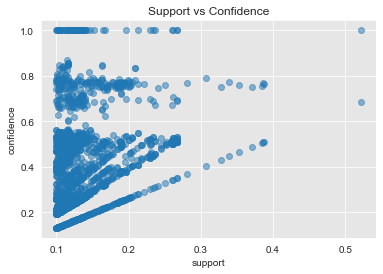

In [64]:
plt.scatter(rules_by_confidence['support'], rules_by_confidence['confidence'], alpha=0.5)
plt.xlabel('support')
plt.ylabel('confidence')
plt.title('Support vs Confidence')
plt.show()

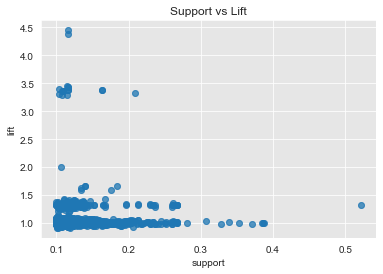

In [65]:
plt.scatter(rules_by_confidence['support'], rules_by_confidence['lift'], alpha=0.5)
plt.xlabel('support')
plt.ylabel('lift')
plt.title('Support vs Lift')
plt.show()

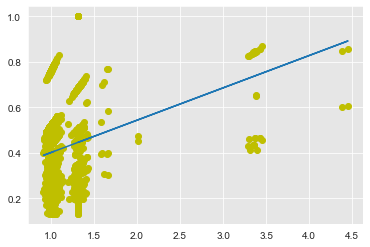

In [66]:
fit = np.polyfit(rules_by_confidence['lift'], rules_by_confidence['confidence'], 1)
fit_fn = np.poly1d(fit)
plt.plot(rules_by_confidence['lift'], rules_by_confidence['confidence'], 'yo', rules_by_confidence['lift'], fit_fn(rules_by_confidence['lift']))

# Training Setup

In [67]:
# Training Setups
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

# Preprocessings
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Classifiers
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.svm import SVC # Support Vector Machine Classifier

RANDOM_STATE = 1 # Used as a seed value
CROSS_VALIDATION_PARTITION = 10

# Optimisation
from sklearn.model_selection import GridSearchCV # tuning the model
from sklearn.model_selection import cross_val_score, cross_validate

# Clustering
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram


In [93]:
learning_data = cleaned_data.drop("id",axis="columns")
target_data = learning_data["is_expensive"]
feature_data = learning_data.drop("is_expensive",axis="columns")
# x_train,x_test,y_train,y_test=train_test_split(feature_data,target_data,test_size=0.3,random_state=0)

# Classification

## Pipeline - Decision Tree Classifier

In [94]:
dt_pipeline_1 = Pipeline([
    ("fill_missing_value", SimpleImputer(strategy="constant",fill_value=0)), # this needs to be changed
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])

In [95]:
dt_pipeline_1_cv =cross_validate(dt_pipeline_1,feature_data,target_data, cv=CROSS_VALIDATION_PARTITION, return_estimator=True)

In [96]:
print(f"All Test Scores: {dt_pipeline_1_cv['test_score']}")
print(f"Mean: {dt_pipeline_1_cv['test_score'].mean()}")
print(f"Standard Deviation: {dt_pipeline_1_cv['test_score'].std()}")

All Test Scores: [0.945 0.93  0.9   0.93  0.95  0.935 0.935 0.95  0.96  0.93 ]
Mean: 0.9364999999999999
Standard Deviation: 0.0156604597633658


## Pipeline - Standard Scaling Decision Tree Classifier

In [97]:
dt_pipeline_2 = Pipeline([
    ("fill_missing_value", SimpleImputer(strategy="constant",fill_value=0)), # this needs to be changed
    ("scale", StandardScaler()),
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])

In [98]:
dt_pipeline_2_cv =cross_validate(dt_pipeline_2,feature_data,target_data, cv=CROSS_VALIDATION_PARTITION, return_estimator=True)

In [99]:
print(f"All Test Scores: {dt_pipeline_2_cv['test_score']}")
print(f"Mean: {dt_pipeline_2_cv['test_score'].mean()}")
print(f"Standard Deviation: {dt_pipeline_2_cv['test_score'].std()}")

All Test Scores: [0.945 0.93  0.9   0.93  0.95  0.935 0.93  0.95  0.96  0.93 ]
Mean: 0.9359999999999999
Standard Deviation: 0.01577973383805947


## Pipeline - Principal Component Analysis with Decision Tree Classifier

In [100]:
dt_pipeline_3 = Pipeline([
    ("fill_missing_value", SimpleImputer(strategy="constant",fill_value=0)), # this needs to be changed
    ("scale", StandardScaler()),
    ("pca", PCA()),
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])

# Grid Search
param_grid = {
    'pca__n_components': range(1,len(feature_data.columns))
}

In [101]:
dt_pipeline_3_search = GridSearchCV(dt_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_3_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('fill_missing_value',
                                        SimpleImputer(fill_value=0,
                                                      strategy='constant')),
                                       ('scale', StandardScaler()),
                                       ('pca', PCA()),
                                       ('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1, param_grid={'pca__n_components': range(1, 20)})

In [102]:
pd.DataFrame(dt_pipeline_3_search.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_pca__n_components,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,0.036323,0.005128,0.006299,0.002602,1,{'pca__n_components': 1},0.630,0.585,0.705,0.630,0.560,0.675,0.595,0.630,0.620,0.655,0.6285,0.040623,18
1,0.032562,0.005448,0.004291,0.001659,2,{'pca__n_components': 2},0.635,0.655,0.640,0.620,0.640,0.610,0.605,0.640,0.580,0.605,0.6230,0.021703,19
2,0.042409,0.005228,0.005996,0.000904,3,{'pca__n_components': 3},0.635,0.635,0.670,0.645,0.640,0.645,0.625,0.595,0.605,0.690,0.6385,0.026368,16
3,0.054297,0.009912,0.006296,0.001942,4,{'pca__n_components': 4},0.600,0.635,0.660,0.675,0.630,0.620,0.620,0.660,0.620,0.645,0.6365,0.022028,17
4,0.052115,0.009217,0.007905,0.008121,5,{'pca__n_components': 5},0.635,0.660,0.710,0.640,0.625,0.635,0.740,0.595,0.615,0.690,0.6545,0.043154,15
5,0.054914,0.009901,0.005693,0.001085,6,{'pca__n_components': 6},0.715,0.685,0.715,0.660,0.660,0.665,0.705,0.700,0.710,0.680,0.6895,0.021266,14
6,0.047319,0.007944,0.005607,0.001746,7,{'pca__n_components': 7},0.635,0.675,0.700,0.725,0.685,0.715,0.680,0.725,0.720,0.720,0.6980,0.027767,13
7,0.052955,0.014896,0.007099,0.004909,8,{'pca__n_components': 8},0.690,0.685,0.730,0.715,0.705,0.745,0.710,0.750,0.745,0.735,0.7210,0.022226,11
8,0.050207,0.002969,0.004602,0.000672,9,{'pca__n_components': 9},0.665,0.710,0.730,0.695,0.715,0.755,0.685,0.735,0.745,0.755,0.7190,0.028965,12
9,0.057096,0.010855,0.007001,0.005452,10,{'pca__n_components': 10},0.750,0.730,0.715,0.760,0.735,0.765,0.770,0.790,0.735,0.680,0.7430,0.029682,10


In [103]:
print(f"Best Test Scores: {dt_pipeline_3_search.best_score_}")
print(f"Best Params: {dt_pipeline_3_search.best_params_}")
print(f"Best CV Index: {dt_pipeline_3_search.best_index_}")

Best Test Scores: 0.813
Best Params: {'pca__n_components': 16}
Best CV Index: 15


## Pipeline - Support Vector Machine

In [104]:
svm_pipeline_1 = Pipeline([
    ("fill_missing_value", SimpleImputer(strategy="constant",fill_value=0)), # this needs to be changed
    ("svm_classifier",SVC())
])

In [105]:
svm_pipeline_1_cv =cross_validate(svm_pipeline_1,feature_data,target_data, cv=CROSS_VALIDATION_PARTITION, return_estimator=True)

In [106]:
print(f"All Test Scores: {svm_pipeline_1_cv['test_score']}")
print(f"Mean: {svm_pipeline_1_cv['test_score'].mean()}")
print(f"Standard Deviation: {svm_pipeline_1_cv['test_score'].std()}")

All Test Scores: [0.98  0.975 0.97  0.985 0.975 0.985 0.99  0.975 0.965 0.985]
Mean: 0.9785
Standard Deviation: 0.00743303437365926


## Pipeline - Standard Scaling Support Vector Machine

In [107]:
svm_pipeline_2 = Pipeline([
    ("fill_missing_value", SimpleImputer(strategy="constant",fill_value=0)), # this needs to be changed    
    ("scale", StandardScaler()),
    ("svm_classifier",SVC())
])

In [108]:
svm_pipeline_2_cv =cross_validate(svm_pipeline_2,feature_data,target_data, cv=CROSS_VALIDATION_PARTITION, return_estimator=True)

In [109]:
print(f"All Test Scores: {svm_pipeline_2_cv['test_score']}")
print(f"Mean: {svm_pipeline_2_cv['test_score'].mean()}")
print(f"Standard Deviation: {svm_pipeline_2_cv['test_score'].std()}")

All Test Scores: [0.945 0.965 0.935 0.97  0.98  0.96  0.95  0.955 0.965 0.985]
Mean: 0.961
Standard Deviation: 0.014628738838327786


## Pipeline - Principal Component Analysis and Support Vector Machine 

In [110]:
svm_pipeline_3 = Pipeline([
    ("fill_missing_value", SimpleImputer(strategy="constant",fill_value=0)), # this needs to be changed    
    ("scale", StandardScaler()),
    ("pca", PCA()),
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'pca__n_components': range(1,len(feature_data.columns)),
    'svm_classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid', 'precomputed']
}

In [111]:
svm_pipeline_3_search = GridSearchCV(svm_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_3_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('fill_missing_value',
                                        SimpleImputer(fill_value=0,
                                                      strategy='constant')),
                                       ('scale', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'pca__n_components': range(1, 20),
                         'svm_classifier__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid', 'precomputed']})

In [112]:
pd.DataFrame(svm_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_pca__n_components,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
85,0.037899,0.016856,0.004301,0.002451,18,linear,"{'pca__n_components': 18, 'svm_classifier__ker...",0.990,0.985,0.990,0.985,1.000,0.990,0.995,1.000,0.990,0.985,0.9910,0.005385,1
80,0.033352,0.005627,0.003599,0.001017,17,linear,"{'pca__n_components': 17, 'svm_classifier__ker...",0.990,0.985,0.990,0.985,0.995,0.995,0.995,1.000,0.990,0.985,0.9910,0.004899,1
90,0.058694,0.006094,0.006598,0.001354,19,linear,"{'pca__n_components': 19, 'svm_classifier__ker...",0.990,0.990,0.995,0.985,0.990,0.985,0.990,0.985,1.000,0.985,0.9895,0.004717,3
75,0.052899,0.008206,0.005699,0.000783,16,linear,"{'pca__n_components': 16, 'svm_classifier__ker...",0.975,0.985,0.980,0.985,0.980,0.980,0.995,0.985,0.985,0.990,0.9840,0.005385,4
88,0.043403,0.015298,0.006795,0.003185,18,sigmoid,"{'pca__n_components': 18, 'svm_classifier__ker...",0.980,0.970,0.980,0.985,0.975,0.980,0.975,0.990,0.970,0.980,0.9785,0.005937,5
83,0.036972,0.002371,0.004930,0.000315,17,sigmoid,"{'pca__n_components': 17, 'svm_classifier__ker...",0.975,0.970,0.980,0.980,0.980,0.985,0.970,0.990,0.975,0.975,0.9780,0.006000,6
93,0.074601,0.012691,0.010897,0.005477,19,sigmoid,"{'pca__n_components': 19, 'svm_classifier__ker...",0.980,0.970,0.975,0.990,0.975,0.985,0.965,0.985,0.970,0.980,0.9775,0.007500,7
78,0.051797,0.004305,0.007300,0.000782,16,sigmoid,"{'pca__n_components': 16, 'svm_classifier__ker...",0.960,0.975,0.990,0.985,0.960,0.980,0.970,0.975,0.965,0.985,0.9745,0.010112,8
70,0.068828,0.011161,0.006887,0.001509,15,linear,"{'pca__n_components': 15, 'svm_classifier__ker...",0.985,0.975,0.960,0.985,0.965,0.965,0.985,0.905,0.940,0.975,0.9640,0.023749,9
82,0.045127,0.003812,0.005332,0.000434,17,rbf,"{'pca__n_components': 17, 'svm_classifier__ker...",0.945,0.970,0.940,0.955,0.985,0.965,0.950,0.955,0.970,0.990,0.9625,0.015692,10


In [113]:
print(f"Best Test Scores: {svm_pipeline_3_search.best_score_}")
print(f"Best Params: {svm_pipeline_3_search.best_params_}")
print(f"Best CV Index: {svm_pipeline_3_search.best_index_}")

Best Test Scores: 0.991
Best Params: {'pca__n_components': 17, 'svm_classifier__kernel': 'linear'}
Best CV Index: 80


# Clustering

## Cluster of Size 2

With the dataset `price_category` or `is_expensive`, it is expected to obtain 2 distinct clusters.

In [ ]:
kmeans_pipeline = Pipeline([
    ("kmeans",KMeans(n_clusters=2, random_state=RANDOM_STATE))
])

# Grid Search
param_grid = {
    'kmeans__n_clusters': range(1,5) # Check 1-5 Clusters
}

In [ ]:
kmeans_pipeline_search = GridSearchCV(kmeans_pipeline, param_grid, n_jobs=-1 )
kmeans_pipeline_search.fit(feature_data)

In [ ]:
kmeans_pipeline_search

In [ ]:
kmeans_pipeline.fit(feature_data)

In [ ]:
kmeans_pipeline.predict(feature_data)

In [ ]:
ac_pipeline = Pipeline([
    ("ac", AgglomerativeClustering(distance_threshold=0,n_clusters=None)) # Compute distances
])

In [ ]:
ac_pipeline.fit(feature_data)

In [ ]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

In [ ]:
# plot the top three levels of the dendrogram
plot_dendrogram(ac_pipeline[0], truncate_mode='level', p=1)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

## Cluster of Size 3

However, examining of 3 distinct cluster is a cross-check procedure to determine that 2 cluster is indeed the more appropriate cluster. Some consideration may be that there are phones that are neither cheap, nor expensive (in the middle group).

## All Attribute